# Network Science
## Project 1
### My VK social network analysis

In [117]:
import requests
import networkx
import time
import collections
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import collections

import scipy.spatial as spt
from networkx.algorithms import community
#import cylouvain

%matplotlib inline

In [1]:
import sys
sys.version

'3.6.5 |Anaconda, Inc.| (default, Mar 29 2018, 13:32:41) [MSC v.1900 64 bit (AMD64)]'

In [2]:
# функция возвращает список друзей
def get_friends_ids(user_id, token):
    friends_url = 'https://api.vk.com/method/friends.get?user_id={}&access_token={}&v=5.92' 
    # также вы можете добавить access_token в запрос, получив его через OAuth 2.0
    resp = requests.get(friends_url.format(user_id, token))         
    assert resp.status_code == 200
    json_response = resp.json()
    
    if json_response.get('error'):
        print(json_response)
        # if json_response['error']['error_code'] == 30:
         #   print('Private profile')
         #   return []
       # elif json_response['error']['error_code'] == 15:
        #    print('Deactivated user')
         #   return[]
        return []
    return json_response['response']['items']

In [23]:
user_id = 22656638
token = '*********************************'

In [3]:
graph = {}
friend_ids = get_friends_ids(user_id, token)  # ваш user id, для которого вы хотите построить граф друзей.
for friend_id in friend_ids:
    graph[friend_id] = get_friends_ids(friend_id, token)
    print ('Processed id: ', friend_id, len(graph[friend_id]) )
    if len(graph[friend_id])==0:                  # delete those who are deleted or private, so we don't know their friends
        del graph[friend_id]

Processed id:  1876 537
Processed id:  14807 699
Processed id:  17413 289
Processed id:  25814 4535
Processed id:  55828 96
Processed id:  56572 2284
Processed id:  65995 658
Processed id:  97723 5000
Processed id:  132319 892
Processed id:  144663 178
Processed id:  155584 764
Processed id:  163460 689
{'error': {'error_code': 30, 'error_msg': 'This profile is private', 'request_params': [{'key': 'oauth', 'value': '1'}, {'key': 'method', 'value': 'friends.get'}, {'key': 'user_id', 'value': '227657'}, {'key': 'v', 'value': '5.92'}]}}
Processed id:  227657 0
Processed id:  231043 1207
Processed id:  231254 1042
Processed id:  263289 689
Processed id:  388904 943
Processed id:  393139 456
Processed id:  395405 1093
Processed id:  434715 126
Processed id:  460055 1077
Processed id:  520688 450
Processed id:  553196 779
Processed id:  729647 422
Processed id:  791662 681
Processed id:  794133 1187
{'error': {'error_code': 30, 'error_msg': 'This profile is private', 'request_params': [{'key

Processed id:  6609242 405
Processed id:  6625510 1198
Processed id:  6694219 250
Processed id:  6702311 581
Processed id:  6703414 702
Processed id:  6859541 166
{'error': {'error_code': 30, 'error_msg': 'This profile is private', 'request_params': [{'key': 'oauth', 'value': '1'}, {'key': 'method', 'value': 'friends.get'}, {'key': 'user_id', 'value': '6919636'}, {'key': 'v', 'value': '5.92'}]}}
Processed id:  6919636 0
Processed id:  7023425 612
Processed id:  7173463 259
Processed id:  7269774 890
Processed id:  7427197 923
{'error': {'error_code': 30, 'error_msg': 'This profile is private', 'request_params': [{'key': 'oauth', 'value': '1'}, {'key': 'method', 'value': 'friends.get'}, {'key': 'user_id', 'value': '7432350'}, {'key': 'v', 'value': '5.92'}]}}
Processed id:  7432350 0
Processed id:  7485256 698
Processed id:  7494942 795
Processed id:  7562824 436
Processed id:  7816053 501
Processed id:  7920892 796
Processed id:  7950724 448
Processed id:  7977189 721
Processed id:  798

{'error': {'error_code': 30, 'error_msg': 'This profile is private', 'request_params': [{'key': 'oauth', 'value': '1'}, {'key': 'method', 'value': 'friends.get'}, {'key': 'user_id', 'value': '15753805'}, {'key': 'v', 'value': '5.92'}]}}
Processed id:  15753805 0
Processed id:  15797787 342
Processed id:  15820577 232
Processed id:  15836348 288
{'error': {'error_code': 30, 'error_msg': 'This profile is private', 'request_params': [{'key': 'oauth', 'value': '1'}, {'key': 'method', 'value': 'friends.get'}, {'key': 'user_id', 'value': '15937615'}, {'key': 'v', 'value': '5.92'}]}}
Processed id:  15937615 0
Processed id:  16012171 2511
Processed id:  16045768 140
Processed id:  16198206 167
Processed id:  16217167 285
Processed id:  16223930 488
{'error': {'error_code': 15, 'error_msg': 'Access denied: user deactivated', 'request_params': [{'key': 'oauth', 'value': '1'}, {'key': 'method', 'value': 'friends.get'}, {'key': 'user_id', 'value': '16315071'}, {'key': 'v', 'value': '5.92'}]}}
Proc

{'error': {'error_code': 30, 'error_msg': 'This profile is private', 'request_params': [{'key': 'oauth', 'value': '1'}, {'key': 'method', 'value': 'friends.get'}, {'key': 'user_id', 'value': '26374113'}, {'key': 'v', 'value': '5.92'}]}}
Processed id:  26374113 0
Processed id:  26443024 20
{'error': {'error_code': 30, 'error_msg': 'This profile is private', 'request_params': [{'key': 'oauth', 'value': '1'}, {'key': 'method', 'value': 'friends.get'}, {'key': 'user_id', 'value': '26446033'}, {'key': 'v', 'value': '5.92'}]}}
Processed id:  26446033 0
Processed id:  26456544 412
Processed id:  26503079 326
Processed id:  26518695 291
Processed id:  26536799 717
{'error': {'error_code': 15, 'error_msg': 'Access denied: user deactivated', 'request_params': [{'key': 'oauth', 'value': '1'}, {'key': 'method', 'value': 'friends.get'}, {'key': 'user_id', 'value': '26762227'}, {'key': 'v', 'value': '5.92'}]}}
Processed id:  26762227 0
Processed id:  26790437 57
{'error': {'error_code': 30, 'error_m

Processed id:  62588453 76
Processed id:  63083442 930
Processed id:  63242901 356
Processed id:  63418158 264
Processed id:  63620827 610
Processed id:  63642548 1254
Processed id:  63687261 306
{'error': {'error_code': 30, 'error_msg': 'This profile is private', 'request_params': [{'key': 'oauth', 'value': '1'}, {'key': 'method', 'value': 'friends.get'}, {'key': 'user_id', 'value': '63825788'}, {'key': 'v', 'value': '5.92'}]}}
Processed id:  63825788 0
Processed id:  63887268 158
Processed id:  63922711 275
Processed id:  64040244 663
Processed id:  64641693 540
Processed id:  64745408 83
Processed id:  65107670 383
Processed id:  65155800 245
{'error': {'error_code': 30, 'error_msg': 'This profile is private', 'request_params': [{'key': 'oauth', 'value': '1'}, {'key': 'method', 'value': 'friends.get'}, {'key': 'user_id', 'value': '65355465'}, {'key': 'v', 'value': '5.92'}]}}
Processed id:  65355465 0
Processed id:  65434434 522
Processed id:  66005350 463
Processed id:  66171062 178

Processed id:  105522823 4211
Processed id:  105604092 146
Processed id:  106001987 206
Processed id:  107442470 853
Processed id:  109548576 363
Processed id:  110372066 296
{'error': {'error_code': 15, 'error_msg': 'Access denied: user deactivated', 'request_params': [{'key': 'oauth', 'value': '1'}, {'key': 'method', 'value': 'friends.get'}, {'key': 'user_id', 'value': '110740636'}, {'key': 'v', 'value': '5.92'}]}}
Processed id:  110740636 0
Processed id:  110830929 675
Processed id:  111020618 661
{'error': {'error_code': 30, 'error_msg': 'This profile is private', 'request_params': [{'key': 'oauth', 'value': '1'}, {'key': 'method', 'value': 'friends.get'}, {'key': 'user_id', 'value': '111193730'}, {'key': 'v', 'value': '5.92'}]}}
Processed id:  111193730 0
Processed id:  111479020 228
{'error': {'error_code': 30, 'error_msg': 'This profile is private', 'request_params': [{'key': 'oauth', 'value': '1'}, {'key': 'method', 'value': 'friends.get'}, {'key': 'user_id', 'value': '11200085

Processed id:  185081231 0
{'error': {'error_code': 30, 'error_msg': 'This profile is private', 'request_params': [{'key': 'oauth', 'value': '1'}, {'key': 'method', 'value': 'friends.get'}, {'key': 'user_id', 'value': '185122599'}, {'key': 'v', 'value': '5.92'}]}}
Processed id:  185122599 0
Processed id:  186083459 263
Processed id:  188080556 68
Processed id:  188917526 5000
Processed id:  189268848 481
Processed id:  191490491 185
Processed id:  192070520 229
Processed id:  192849268 430
Processed id:  194042531 440
Processed id:  196445557 582
{'error': {'error_code': 30, 'error_msg': 'This profile is private', 'request_params': [{'key': 'oauth', 'value': '1'}, {'key': 'method', 'value': 'friends.get'}, {'key': 'user_id', 'value': '197001848'}, {'key': 'v', 'value': '5.92'}]}}
Processed id:  197001848 0
Processed id:  197222828 664
Processed id:  197990570 185
Processed id:  199652777 404
{'error': {'error_code': 30, 'error_msg': 'This profile is private', 'request_params': [{'key':

Processed id:  301673607 304
Processed id:  306731648 318
Processed id:  308072821 353
Processed id:  311158035 684
Processed id:  315811211 3022
{'error': {'error_code': 30, 'error_msg': 'This profile is private', 'request_params': [{'key': 'oauth', 'value': '1'}, {'key': 'method', 'value': 'friends.get'}, {'key': 'user_id', 'value': '318200501'}, {'key': 'v', 'value': '5.92'}]}}
Processed id:  318200501 0
Processed id:  319266898 1013
Processed id:  322273494 779
{'error': {'error_code': 15, 'error_msg': 'Access denied: user deactivated', 'request_params': [{'key': 'oauth', 'value': '1'}, {'key': 'method', 'value': 'friends.get'}, {'key': 'user_id', 'value': '322728589'}, {'key': 'v', 'value': '5.92'}]}}
Processed id:  322728589 0
{'error': {'error_code': 15, 'error_msg': 'Access denied: user deactivated', 'request_params': [{'key': 'oauth', 'value': '1'}, {'key': 'method', 'value': 'friends.get'}, {'key': 'user_id', 'value': '328446806'}, {'key': 'v', 'value': '5.92'}]}}
Processed i

In [4]:
len(graph)

903

In [5]:
g = networkx.Graph(directed=False)
# соединяем друзей дружащих друг с другом
for i in graph:
    g.add_node(i)
    for j in graph[i]:
        if i != j and i in friend_ids and j in friend_ids:
            g.add_edge(i, j)

In [6]:
# сохраняем
networkx.write_gml(g, "vk_network.gml")

In [4]:
G = nx.read_gml('vk_network.gml')

In [5]:
L = nx.subgraph(G, list(nx.connected_components(G))[0])

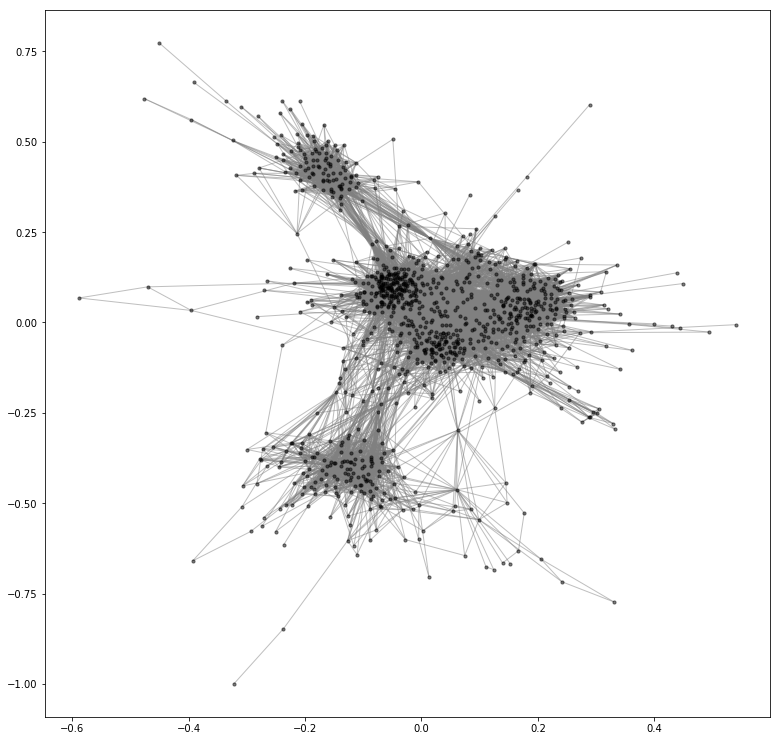

In [8]:
def draw_large(G):
    fig = plt.figure(1, figsize=(13,13))
    nx.draw_networkx(G,
          node_size = 10,
          node_color='black',
          font_size=14,
          edge_color = 'gray',
          font_color='black',
          with_labels = False,
          alpha=0.5       
          )
draw_large(L)

Even here, on simple graph, we can see some clusters. Let's make miningful labels now.

In [6]:
def info_about(user_id, token='31735d2131735d2131735d21ed312e2ad13317331735d21680479f80bb70a7b7d66fca7'):
 
    url = 'https://api.vk.com/method/users.get?user_ids={}&access_token={}&fields={}&v=5.92'.format(user_id,token, 'sex,bdate,city,universities')
    resp=requests.get(url).json() 
    return resp['response'][0]

In [128]:
info_about('22656638',token)

{'id': 22656638,
 'first_name': 'Yulia',
 'last_name': 'Gurova',
 'is_closed': False,
 'can_access_closed': True,
 'sex': 1,
 'bdate': '11.12',
 'city': {'id': 1, 'title': 'Moscow'}}

In [25]:
attrs = {}
for node in list(L.nodes()):
    attrs[node] = info_about(node,token)

In [26]:
nx.set_node_attributes(L, attrs)

In [56]:
print( '# of vertices:', L.number_of_nodes(), '  # of edges:', L.number_of_edges())
print( 'radius:', nx.radius(L))
print( 'diameter:', nx.diameter(L))
print('order:', L.order())

# of vertices: 1050   # of edges: 22764
radius: 5
diameter: 9
order: 1050


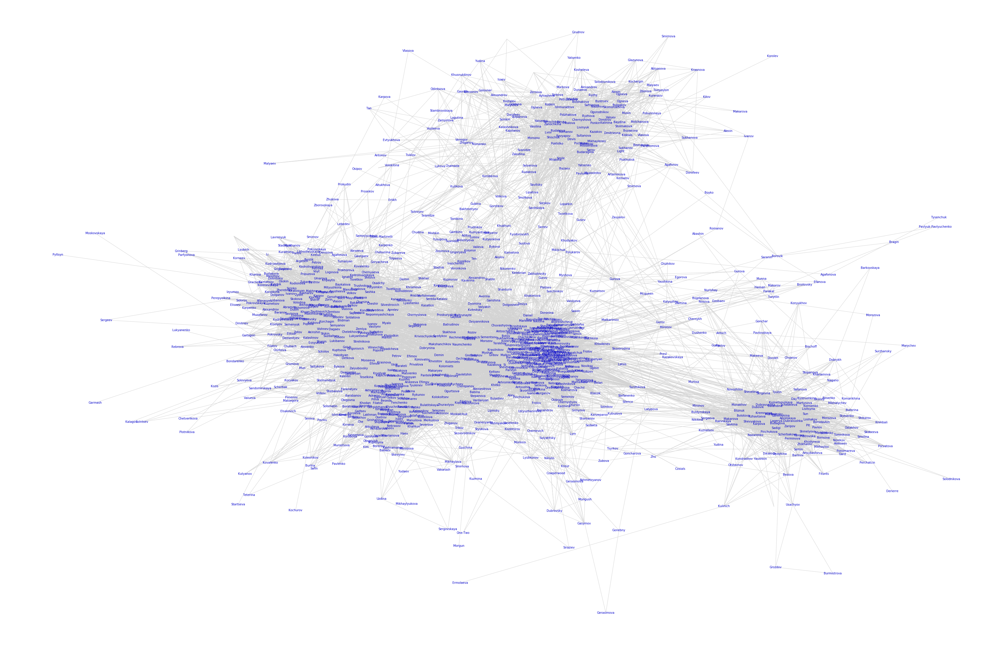

In [120]:
plt.figure(1, figsize=(60,40))
plt.axis('off')

pos = nx.spring_layout(L, k=6/np.sqrt(L.order()))

nx.draw_networkx(L,
                 pos=pos,
          node_size = 0,
          node_color='black',
          font_size=10,
          edge_color = 'lightgrey',
          font_color='mediumblue',
                 with_labels=True,
                 labels=nx.get_node_attributes(L, 'last_name'),
          # alpha=0.8    
          )
plt.savefig('mvk_network.png')

This is unreadable, but it makes a lot of sence if you are looking closer. I tried other layouts: circular_layout, shell, spectral and even random layouts, they all look much worser, believe me.

## Degree distribution. 
Now we study degree distribution. 

In [127]:
deg = dict(nx.degree(L))

In [136]:
sorted_nodes = [(k,v) for k, v in deg.items()]
sorted_nodes=sorted(sorted_nodes, key= lambda x: x[1], reverse = True)

In [137]:
for k,f in sorted_nodes[:20]:
    print(info_about(k)['last_name'], f)

Sts 238
Fyodorovykh 229
Ozoglu 220
Sadykov 208
Tint 204
Glozman 200
Prokofyev 190
Gordeeva 189
Miller 185
Frankenberg 183
Buzila 183
Belyakova 183
Levitskaya 183
Gulina 180
Dmitrieva 180
Drobyshevskaya 180
Okunev 179
Levina 178
Nesterenko 177
Efimenko 175


These are the people, with whom I have the largest number of common friends. The highest one -- StS is the page of a student organisation, and all listed people but Fedorovykh are the members of that organisation and friends to each other. And Danil Fedorovykh is my boyfriend.

Text(0,0.5,'prob of having degree k')

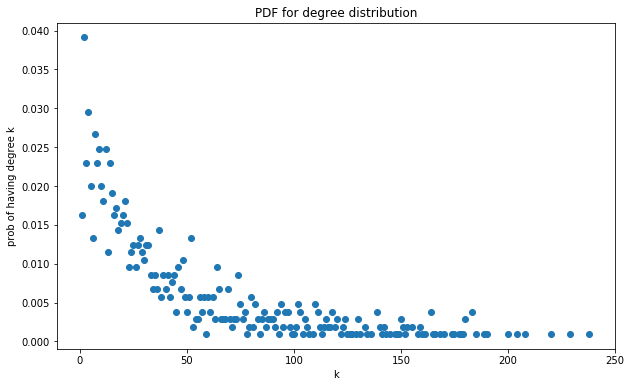

In [143]:
degree_sequence = sorted(dict(L.degree()).values(), reverse=True)
degreeCount = collections.Counter(degree_sequence)
k=sorted(degreeCount.keys())
s=sum(degreeCount.values())
pdf=[degreeCount[i]/s for i in k]


fig = plt.figure(figsize=(10,6))
plt.plot(k, pdf,'o')
plt.title('PDF for degree distribution')
plt.xlabel('k')
plt.ylabel('prob of having degree k')

[-1.77727769 -0.94065427]
Estinmated alpha (or gamma) is  0.9406542746990326


(-1.7772776862193527, 0.9406542746990326)

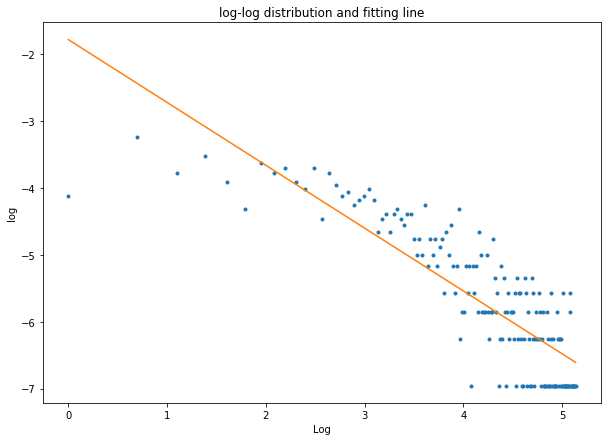

In [144]:
def powerlaw_est(l):
    y_est=np.log([i for i in l if i!=0])
    x_est=np.log(range(1,len(y_est)+1))

    # matrix X
    matriX = np.vstack([np.ones(len(x_est)), x_est]).T

    # OLS coefficients
    Beta = np.dot(np.dot(np.linalg.inv(np.dot(matriX.T, matriX)), matriX.T), y_est)
    print(Beta)

    plt.figure(figsize = (10,7))
    plt.plot(x_est, y_est, '.')
    plt.plot(x_est, [i*Beta[1] + Beta[0] for i in x_est], '-')
    plt.title('log-log distribution and fitting line')
    plt.xlabel('Log')
    plt.ylabel('log')
    print('Estinmated alpha (or gamma) is ',-Beta[1])
    return Beta[0], -Beta[1]
powerlaw_est(pdf)

So, we build the probability density function and the log-log scale to check if it satisfies the power law. Looks like it does not, actually.

## Diameter, shortest paths, clustering

In [151]:
print(nx.number_of_nodes(L))
print(np.mean(degree_sequence))

1048
43.19083969465649


In [148]:
print('diameter:', nx.diameter(L))
print('average shortest path length:', nx.average_shortest_path_length(L))
print('clustering coefficient (transitivity):',nx.transitivity(L))

diameter: 9
average shortest path length: 2.924524450082752
clustering coefficient (transitivity): 0.5090914285189557


So, the network satisfies the small-world properties, having small diameter and average shortest path, and rather high clustering coefficient.

# Structural Analysis

## Degree/Closeness/Betweenness centralities. Top nodes interpretation

Previously there were listed the top nodes according to their degree. As for degree centrality we devide these degrees for the same number, the top will be the same. But if the centrality itself is interesting, let's repeat that. 

In [57]:
degree = nx.algorithms.centrality.degree_centrality(L)
eigenvector =  nx.eigenvector_centrality_numpy(L)
closeness = nx.closeness_centrality(L)
btw = nx.betweenness_centrality(L)

In [58]:
def print_highest(degree):
    highest_degree = [(k,v) for k, v in dict(degree).items()]
    highest_degree=sorted(highest_degree, key= lambda x: x[1], reverse = True)
    for k,a in highest_degree[:20]:
        print(info_about(k)['last_name'], "{0:.4f}".format(a))

In [68]:
def high_graph(deg, t, graph, save_name, nodesize=1000):
    degree = dict(deg)
    filtered_nodes = [k for k, v in degree.items() if v > t]
    subgraph = nx.subgraph(graph, filtered_nodes)

    
    rang = [degree[i] for i in subgraph.nodes()]

#    degree = nx.degree(subgraph)
    labels = nx.get_node_attributes(subgraph, 'last_name')

    plt.figure(1, figsize=(30,20))
    plt.axis('off')
    pos = nx.spring_layout(subgraph, k=5/np.sqrt(subgraph.order()))
    nx.draw_networkx(subgraph,
                     pos=pos,
                     node_size = nodesize,
                     node_color=rang,
                     font_size=18,
                     font_color='red',
                     cmap=plt.cm.Blues,
                     with_labels=True,
                     labels=labels,
                     edge_color='lightgrey',
                     alpha=1)
    plt.savefig(save_name)

In [202]:
print('The nodes with highest degree centrality')
print_highest(degree)

The nodes with highest degree centrality
Sts 0.2273
Fyodorovykh 0.2187
Ozoglu 0.2101
Sadykov 0.1987
Tint 0.1948
Glozman 0.1910
Prokofyev 0.1815
Gordeeva 0.1805
Miller 0.1767
Frankenberg 0.1748
Buzila 0.1748
Belyakova 0.1748
Levitskaya 0.1748
Gulina 0.1719
Dmitrieva 0.1719
Drobyshevskaya 0.1719
Okunev 0.1710
Levina 0.1700
Nesterenko 0.1691
Efimenko 0.1671


These are the people, with whom I have the largest number of common friends. The highest one -- StS is the page of a student organisation, and all listed people but Fedorovykh are the members of that organisation and friends to each other. And Danil Fedorovykh is my boyfriend.

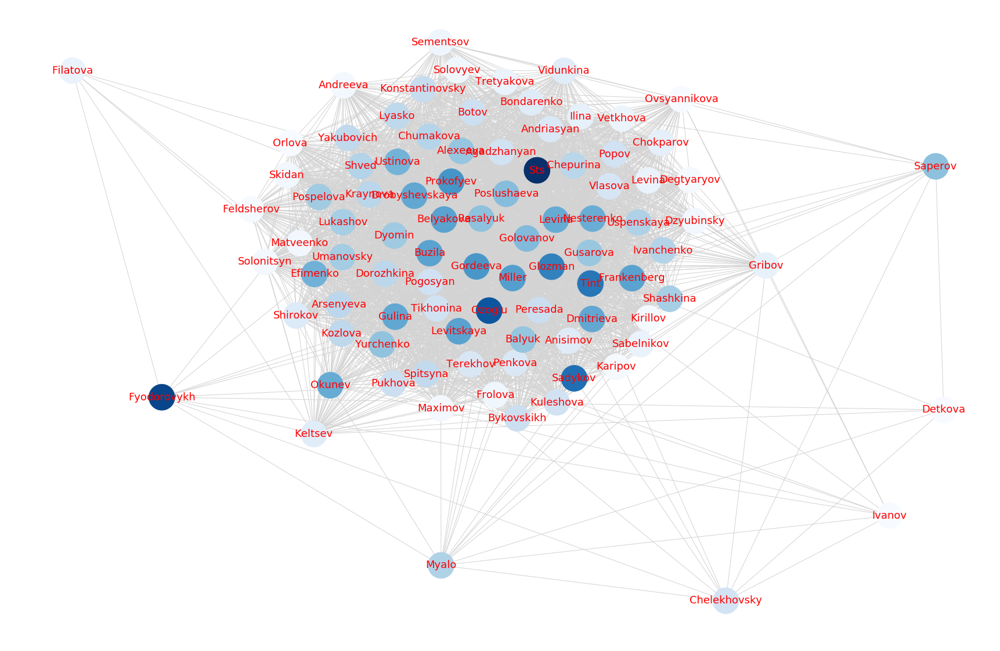

In [66]:
high_graph(degree, 0.11,L,'degree.png',nodesize = 2000)

In [166]:
print('The nodes with highest closeness centrality')
print_highest(closeness)

The nodes with highest closeness centrality
Sts 0.4906
Fyodorovykh 0.4858
Sadykov 0.4723
Okunev 0.4712
Tint 0.4672
Ozoglu 0.4623
Glozman 0.4620
Efimenko 0.4586
Frankenberg 0.4566
Myalo 0.4546
Keltsev 0.4538
Filatova 0.4532
Saperov 0.4436
Chelekhovsky 0.4431
Sementsov 0.4431
Gusarova 0.4429
Shashkina 0.4416
Kolomiets 0.4416
Ivanov 0.4408
Prokofyev 0.4407


First pages in this list are the pages with the highest amount of friends. There are couple of very popular at student's life guys, some central people of the friends companies in which I'm included. And, surprisingly, my best friend Liza Filatova, who has only less then 500 friends, which is smaller then the other people in the list (they have more than 1000 mostly). That is because she knows at least somebody in all my groups of friends, and so he becomes central here.

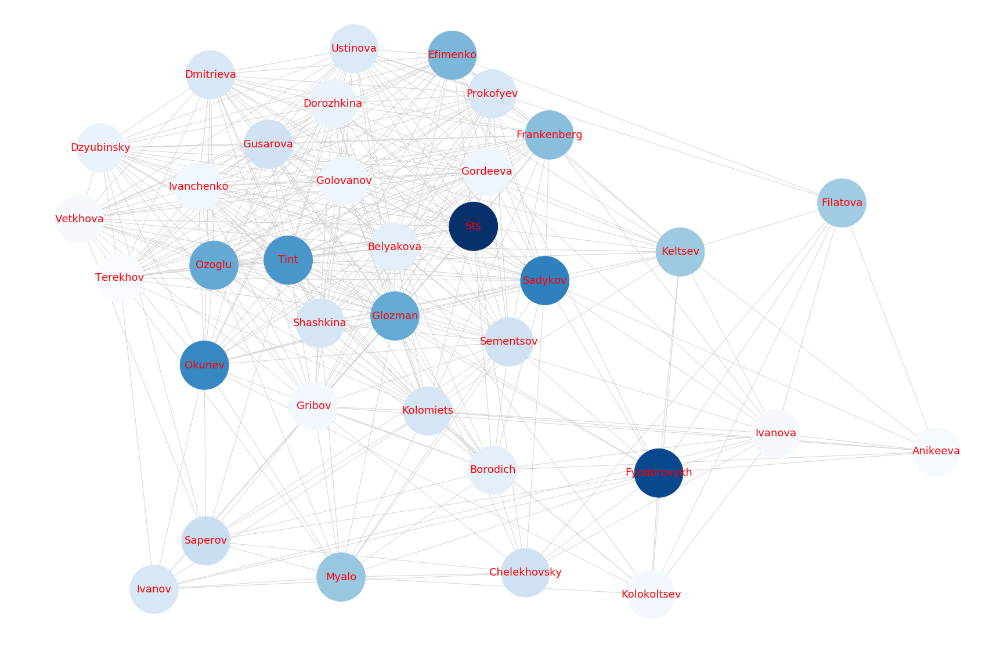

In [71]:
high_graph(closeness, 0.43,L,'close.png',nodesize=7000)

In [167]:
print('The nodes with highest Betweenness centrality')
print_highest(btw)

The nodes with highest Betweenness centrality
Fyodorovykh 0.0864
Filatova 0.0574
Frankenberg 0.0530
Sts 0.0405
Sadykov 0.0365
Dubravushka 0.0332
Kantemirovsky 0.0328
Okunev 0.0287
Gurova 0.0287
Surzhikova 0.0264
Volkova 0.0250
Tareev 0.0233
Tsvetkova 0.0225
Efimenko 0.0221
Myalo 0.0219
Gurov 0.0219
Bazaev 0.0211
Kulikova 0.0201
Dyomina 0.0193
Saperov 0.0185


Here the first one is my boyfriend again, he has a lot of connections to different groups of my friends. And the second one is my best frind, who has much less number of connections, but is connected to different groups as well. And (wow) my mom is  the ningth in the list, despite she has less than 200 friends and only 25 common with me/ But of course, these are my best friends from different periods of life, so she is among the most central as well. 
So, I find the degree centrality on my connections graph the most informative for searching my closest people in the network. 

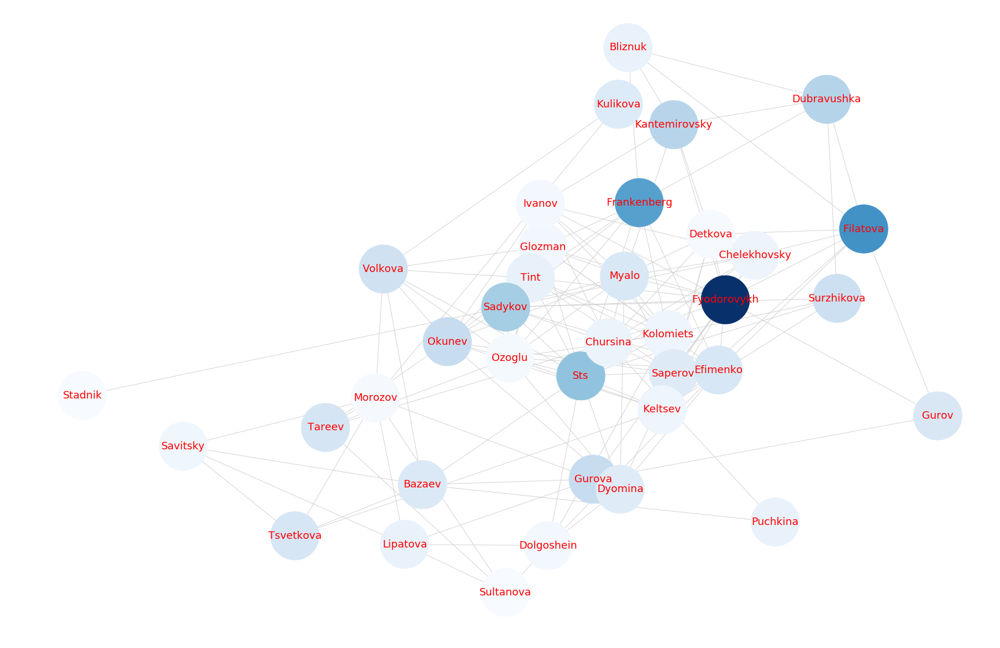

In [74]:
high_graph(btw, 0.01,L,'btw.png', nodesize=7000)

In [168]:
print('The nodes with highest eigenvector centrality')
print_highest(eigenvector)

The nodes with highest eigenvector centrality
Ozoglu 0.1136
Sts 0.1109
Gordeeva 0.1077
Levitskaya 0.1073
Miller 0.1065
Drobyshevskaya 0.1060
Prokofyev 0.1055
Levina 0.1049
Glozman 0.1047
Belyakova 0.1047
Gulina 0.1044
Buzila 0.1021
Nesterenko 0.1020
Alexeeva 0.1015
Tint 0.1013
Dmitrieva 0.1011
Ustinova 0.1011
Resalyuk 0.1008
Yurchenko 0.1007
Balyuk 0.0988


All these people are from the largest and highly connected to each other group of my friends, with whom I was a member of the student organisation Ingroup StS. And the second page on the list is the page of this organisation. So, not surprisingly, the highest people here are from the same group as the connection to the highest centrality person increases your centrality in the case of eigenvector centrality.

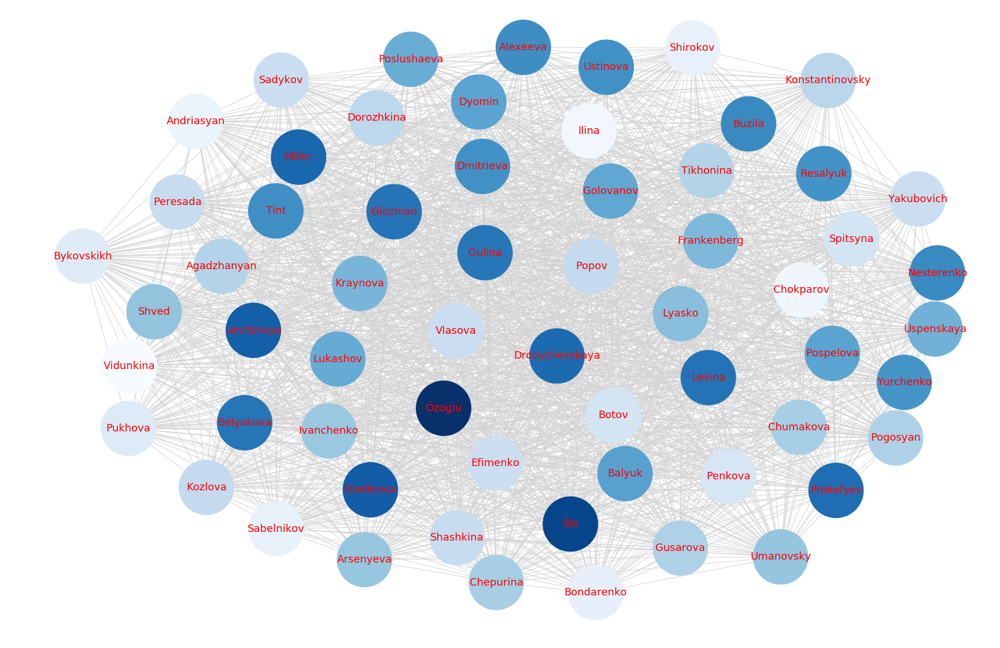

In [76]:
high_graph(eigenvector, 0.08,L,'eig.png', nodesize=9000)

## Page-Rank. Comparison with centralities

I've built an undirected graph, so page-rank centrality is not helpfol for searching new information. It will be the same as degree centrality (if alpha = 1), so I will check just once for the smaller alpha. I think, that the rank among the vertices will be still the same.

In [80]:
# just to check that it is the same as degree centrality
pr = nx.pagerank(L, alpha=1)
print('The nodes with highest Page-Rank centrality')
print_highest(pr)

The nodes with highest Page-Rank centrality
Sts 0.0052
Fyodorovykh 0.0049
Ozoglu 0.0048
Sadykov 0.0045
Tint 0.0044
Glozman 0.0043
Prokofyev 0.0041
Gordeeva 0.0041
Miller 0.0040
Frankenberg 0.0040
Belyakova 0.0040
Levitskaya 0.0040
Buzila 0.0040
Dmitrieva 0.0039
Gulina 0.0039
Drobyshevskaya 0.0039
Okunev 0.0039
Levina 0.0038
Nesterenko 0.0038
Efimenko 0.0038


In [81]:
pr = nx.pagerank(L, alpha=0.7)
print('The nodes with highest Page-Rank centrality')
print_highest(pr)

The nodes with highest Page-Rank centrality
Fyodorovykh 0.0050
Dubravushka 0.0036
Filatova 0.0034
Saperov 0.0031
Sadykov 0.0031
Sts 0.0030
Myalo 0.0028
Morozov 0.0028
Chelekhovsky 0.0027
Fominsky 0.0027
Okunev 0.0026
Efimenko 0.0026
Gurova 0.0025
Tint 0.0025
Ozoglu 0.0025
Dyomina 0.0024
Glozman 0.0024
Bliznuk 0.0023
Frankenberg 0.0023
Koroleva 0.0022


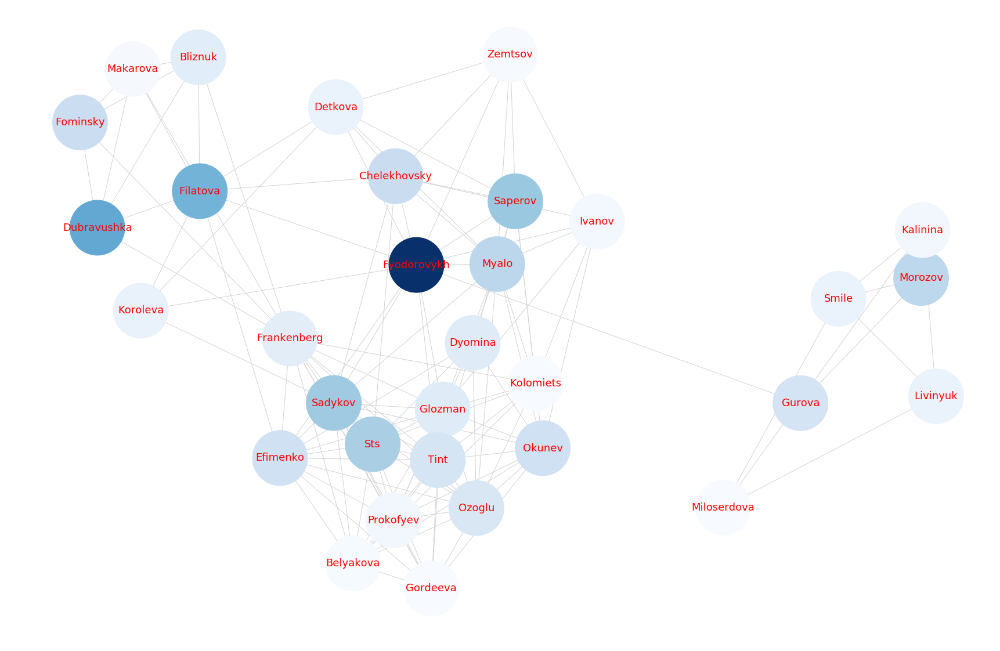

In [82]:
high_graph(pr, 0.002,L,'pr.png', nodesize=9000)

These are people, central in different groups of friends (they cross a lot with the ones with highest betweennes centrality). Because I took a=0.7, the random walks was not stuck completely in between the densiest STS group, but went through the central people at each group of friends.

## Communities detection

As graph is too large, it takes plenty of time to detect communities here. So I take the subgraph of nodes with highest  centrality to detect communities there.

203


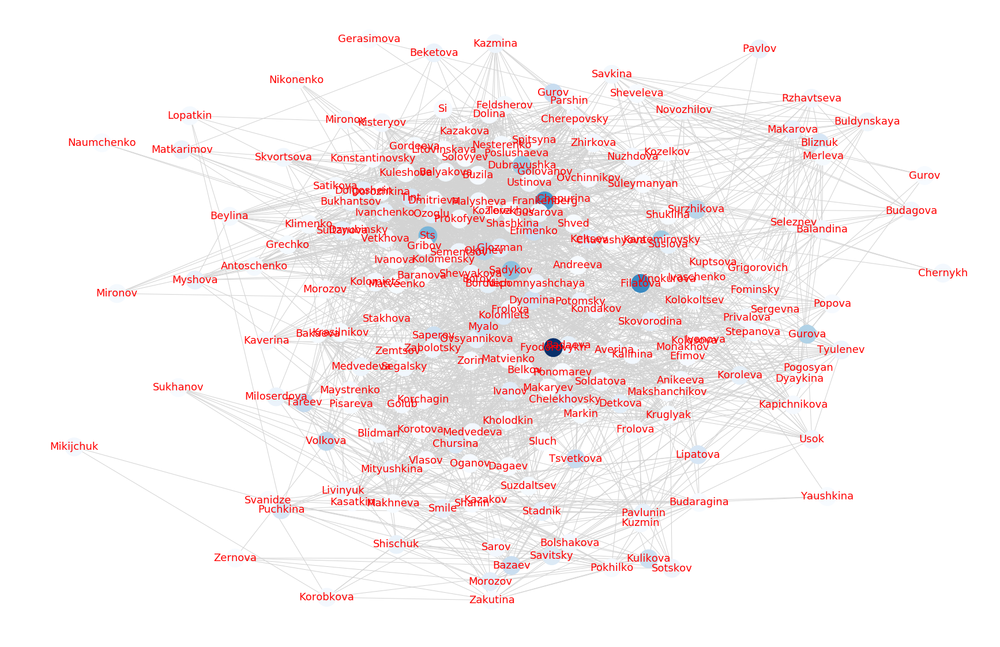

In [32]:
filtered_nodes = [k for k, v in btw.items() if v > 0.002]
S = nx.subgraph(L, filtered_nodes)
print(S.number_of_nodes())
high_graph(btw, 0.002,L,'btw_l.png')

In [33]:
communities_generator = community.k_clique_communities(S,5)

In [34]:
clique_communities=list(communities_generator)

In [85]:
clique_color={}
i=3
for c in clique_communities:
    for node in c:
        clique_color[node] = i
    i+=1
for n in S.nodes():
    clique_color[n]=clique_color.get(n,1)*3
len(clique_color) == S.number_of_nodes()

True

In [86]:
clique_color

{'24700292': 9,
 '197222828': 9,
 '12963616': 9,
 '111020618': 9,
 '69825487': 12,
 '32845942': 12,
 '233733281': 9,
 '104035593': 9,
 '153791256': 9,
 '103006701': 9,
 '4090849': 9,
 '58371031': 9,
 '146073481': 12,
 '15156308': 9,
 '9089606': 9,
 '1137289': 9,
 '14374234': 9,
 '132600488': 9,
 '51525163': 9,
 '95308191': 9,
 '13123269': 12,
 '27192334': 12,
 '2523031': 12,
 '60712657': 12,
 '85010167': 12,
 '24834795': 12,
 '51058092': 12,
 '76864056': 12,
 '33818387': 12,
 '21269271': 12,
 '7269774': 12,
 '32369122': 12,
 '2543380': 12,
 '27001246': 12,
 '48078131': 12,
 '2322235': 12,
 '19938967': 12,
 '105522823': 12,
 '553196': 12,
 '25628758': 12,
 '9559540': 12,
 '6625510': 12,
 '27094302': 12,
 '21917994': 15,
 '72203807': 12,
 '41701144': 12,
 '16223930': 12,
 '3809201': 12,
 '57327561': 12,
 '2881398': 12,
 '25232674': 12,
 '15753805': 12,
 '26374113': 12,
 '64040244': 12,
 '184522054': 12,
 '14241945': 12,
 '99624854': 12,
 '15562886': 12,
 '33392564': 12,
 '3958533': 12,
 

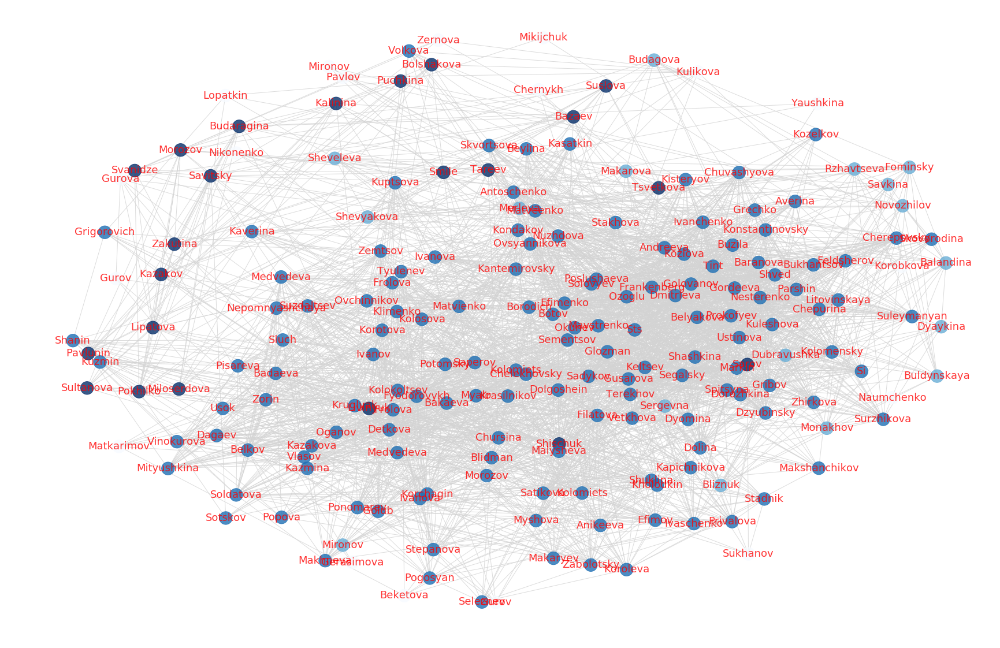

In [91]:
plt.figure(1, figsize=(30,20))
plt.axis('off')
pos = nx.spring_layout(S, k=17/np.sqrt(S.order()))
labels = nx.get_node_attributes(S, 'last_name')
nx.draw_networkx(S,
                     pos=pos,
                     node_size = 500,
                     node_color=[clique_color[n] for n in S.nodes()],
                     font_size=18,
                     font_color='red',
                     cmap=plt.cm.Blues,
                     with_labels=True,
                    labels=labels,
                    edge_color='lightgrey',
                     alpha=0.8
                )
plt.savefig('cliques.png')

Here there are 3 cliques with different shades of blue and the rest nodes are white.

In [9]:
core_numbers = nx.core.core_number(L)

In [10]:
max(core_numbers.values())

72

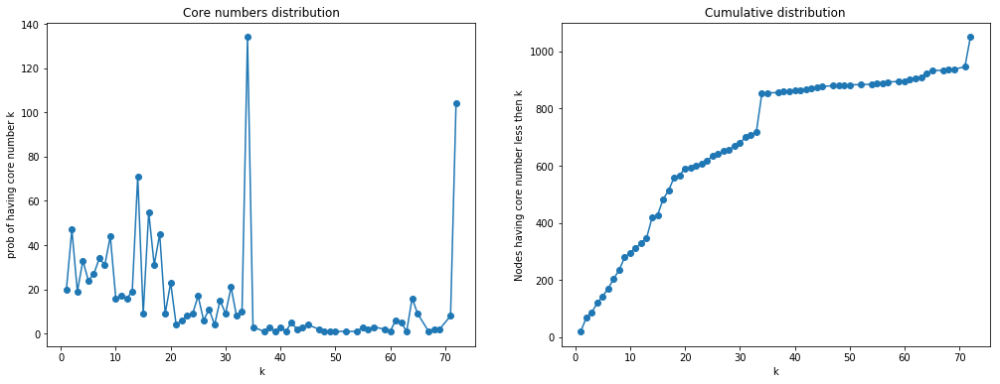

In [29]:
def pdf_cdf(d):
    ''' Plots CDF and PDF of graph G'''
    degree_sequence = sorted(d.values(), reverse=True)
    degreeCount = collections.Counter(degree_sequence)
    k=sorted(degreeCount.keys())
    s=sum(degreeCount.values())
    pdf=[degreeCount[i] for i in k]
    cdf=[sum(pdf[:i+1]) for i in range(len(pdf))]
    
    fig = plt.figure(figsize=(17,6))
    plt.subplot(1,2,1)
    plt.plot(k, pdf,'-o')
    plt.title('Core numbers distribution')
    plt.xlabel('k')
    plt.ylabel('prob of having core number k')
    
    plt.subplot(1,2,2)
    plt.plot(k, cdf,'-o')
    plt.title('Cumulative distribution')    
    plt.xlabel('k')
    plt.ylabel('Nodes having core number less then k')

    return pdf,cdf,k
_ = pdf_cdf(core_numbers)

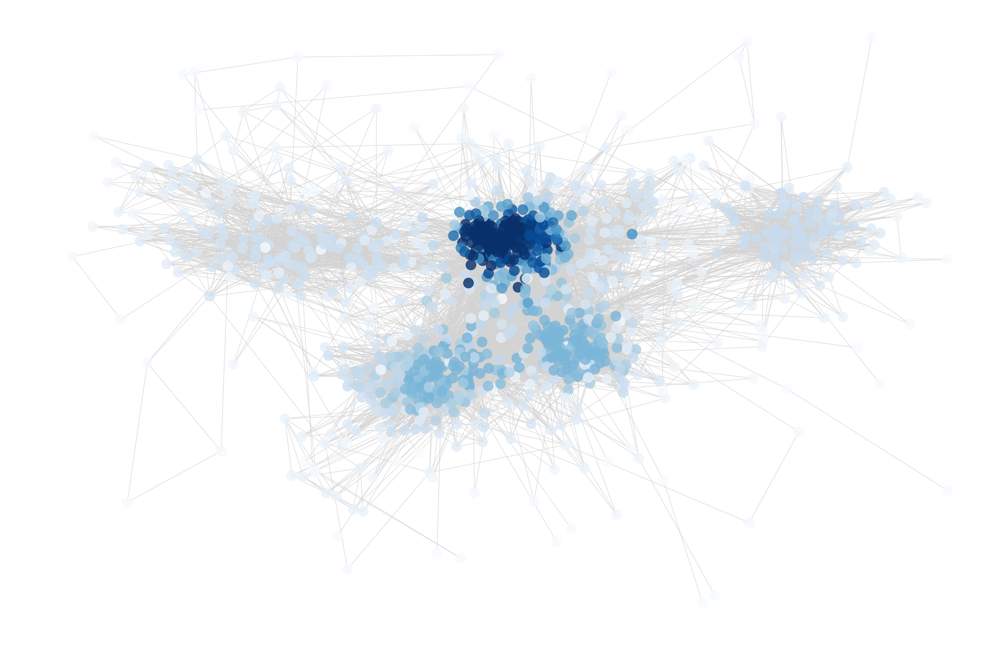

In [103]:
plt.figure(1, figsize=(30,20))
plt.axis('off')
pos = nx.spring_layout(L, k=5/np.sqrt(L.order()))
labels = nx.get_node_attributes(L, 'last_name')
nx.draw_networkx(L,
                     pos=pos,
                     node_size = 300,
                     node_color=[core_numbers[n] for n in L.nodes()],
                     font_size=18,
                     font_color='red',
                     cmap=plt.cm.Blues,
                     with_labels=False,
                  #  labels=labels,
                    edge_color='lightgrey',
                     alpha=0.8
                )
plt.savefig('core_numbers.png')

738


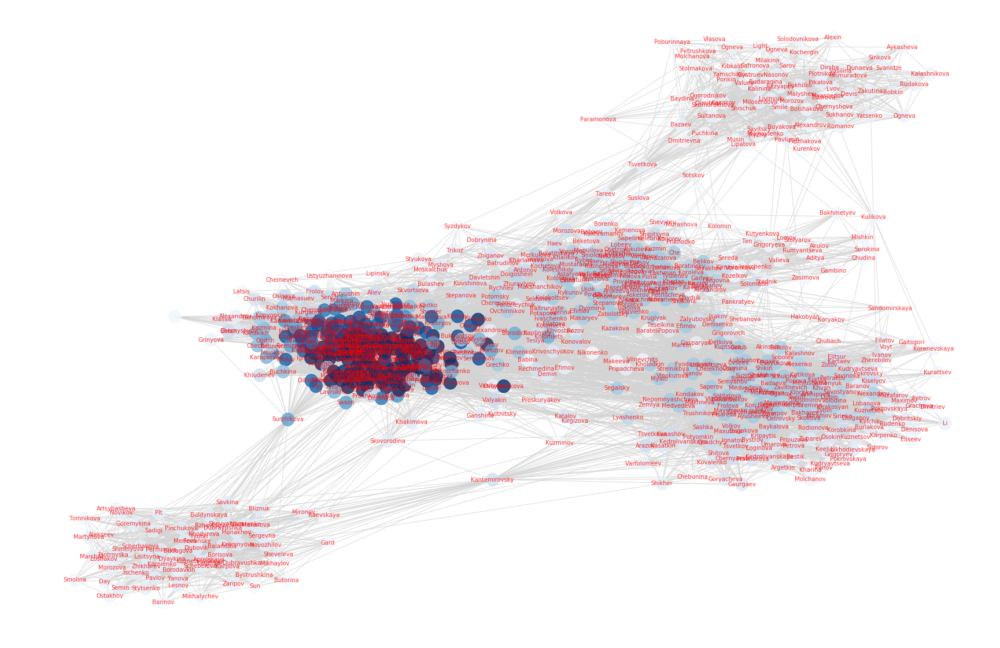

In [83]:
subgraph = nx.subgraph(L, list(nx.core.k_core(L,12)))
plt.figure(1, figsize=(30,20))
plt.axis('off')
pos = nx.spring_layout(subgraph, k=5/np.sqrt(subgraph.order()))
labels = nx.get_node_attributes(subgraph, 'last_name')
nx.draw_networkx(subgraph,
                     pos=pos,
                     node_size = 500,
                     node_color=[core_numbers[n] for n in subgraph.nodes()],
                     font_size=10,
                     font_color='red',
                     cmap=plt.cm.Blues,
                     with_labels=True,
                    labels=labels,
                    edge_color='lightgrey',
                     alpha=0.8
                )
print(subgraph.number_of_nodes())
plt.savefig('12_core_without lables.png')

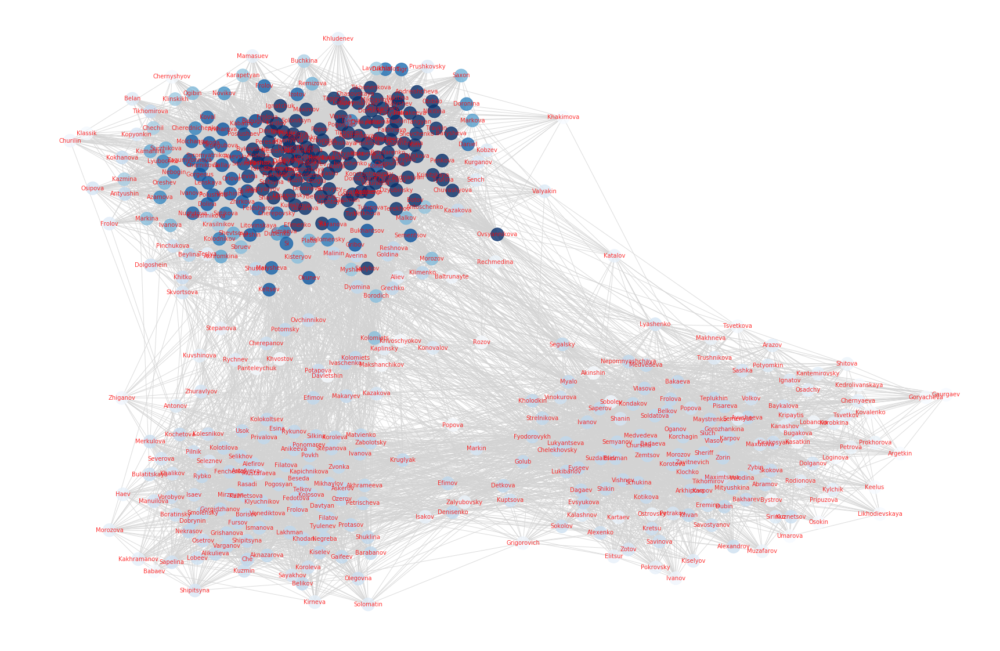

In [31]:
subgraph = nx.subgraph(L, list(nx.core.k_core(L,20)))
plt.figure(1, figsize=(30,20))
plt.axis('off')
pos = nx.spring_layout(subgraph, k=5/np.sqrt(subgraph.order()))
labels = nx.get_node_attributes(subgraph, 'last_name')
nx.draw_networkx(subgraph,
                     pos=pos,
                     node_size = 500,
                     node_color=[core_numbers[n] for n in subgraph.nodes()],
                     font_size=10,
                     font_color='red',
                     cmap=plt.cm.Blues,
                     with_labels=True,
                    labels=labels,
                    edge_color='lightgrey',
                     alpha=0.8
                )
plt.savefig('20_core.png')

In [32]:
core_20 = subgraph

In [33]:
core_20.number_of_nodes()

483

In [34]:
communities_generator = community.greedy_modularity_communities(core_20)
core_mod_communities=list(communities_generator)

In [86]:
len(core_mod_communities)

3

In [106]:
def color_communities(communities,subgraph, lab = False,nodesize = 500,fontsize=10):    
    clique_color={}
    i=1
    for c in communities:
        for node in c:
            clique_color[node] = i
        i+=1
    for n in subgraph.nodes():
        clique_color[n]=clique_color.get(n,i+1)*3
    
    plt.figure(1, figsize=(60,40))
    plt.axis('off')
    pos = nx.spring_layout(subgraph, k=5/np.sqrt(subgraph.order()))
    labels = nx.get_node_attributes(subgraph, 'last_name')
    nx.draw_networkx(subgraph,
                         pos=pos,
                         node_size = nodesize,
                         node_color=[clique_color[n] for n in subgraph.nodes()],
                         font_size=fontsize,
                         font_color='red',
                     #   cmap=plt.cm.winter,
                         with_labels=lab,
                        labels=labels,
                        edge_color='lightgrey',
                         alpha=0.8
                    )
    print(subgraph.number_of_nodes())
    plt.savefig('12_core_without lables.png')
    

483


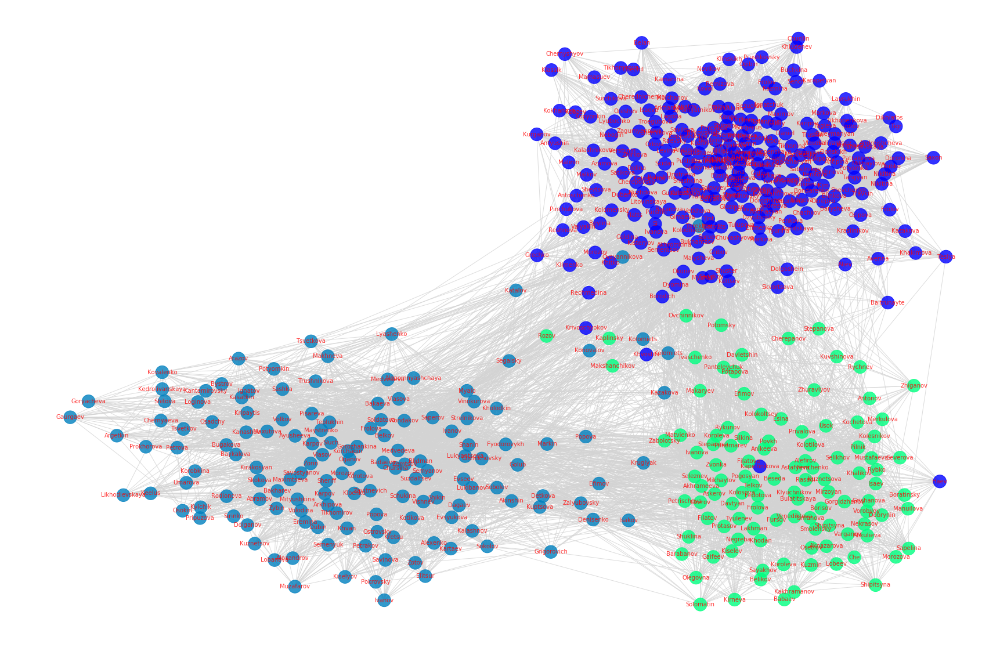

In [98]:
color_communities(core_mod_communities,core_20, lab=True)

In [88]:
communities_generator = community.asyn_fluidc(core_20,3)

In [89]:
core_fluidc_communities=list(communities_generator)

483


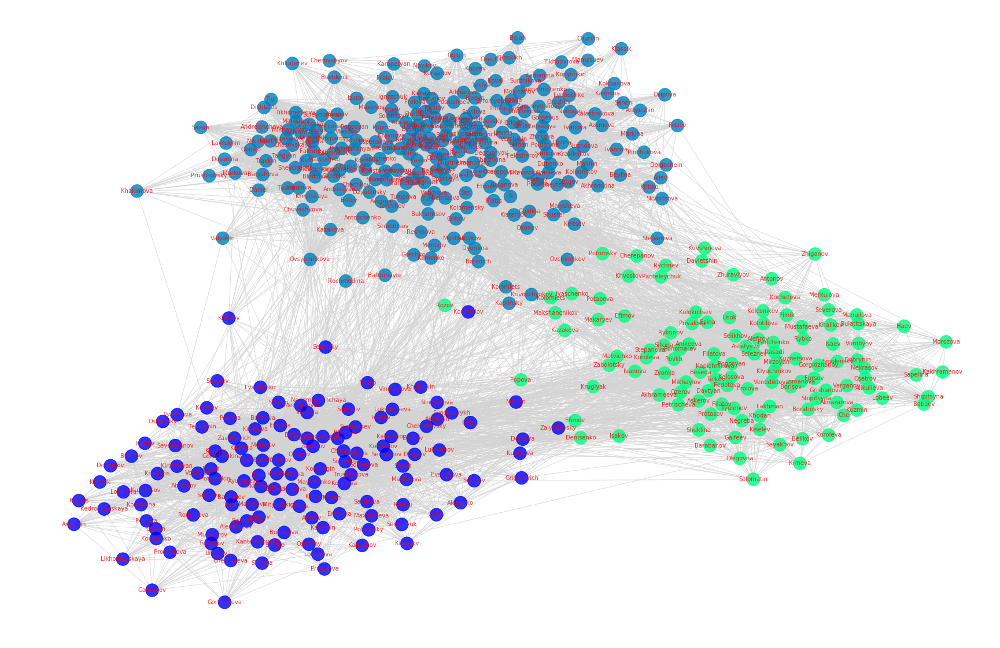

In [99]:
 color_communities(core_fluidc_communities,core_20, lab=True)

In [110]:
communities_generator = community.centrality.girvan_newman(core_20,3)

In [115]:
for i in set(communities_generator):
    print(i)

In [41]:
communities_generator = community.greedy_modularity_communities(L)

In [42]:
total_mod_communities=list(communities_generator)

In [44]:
len(total_mod_communities)

10

1050


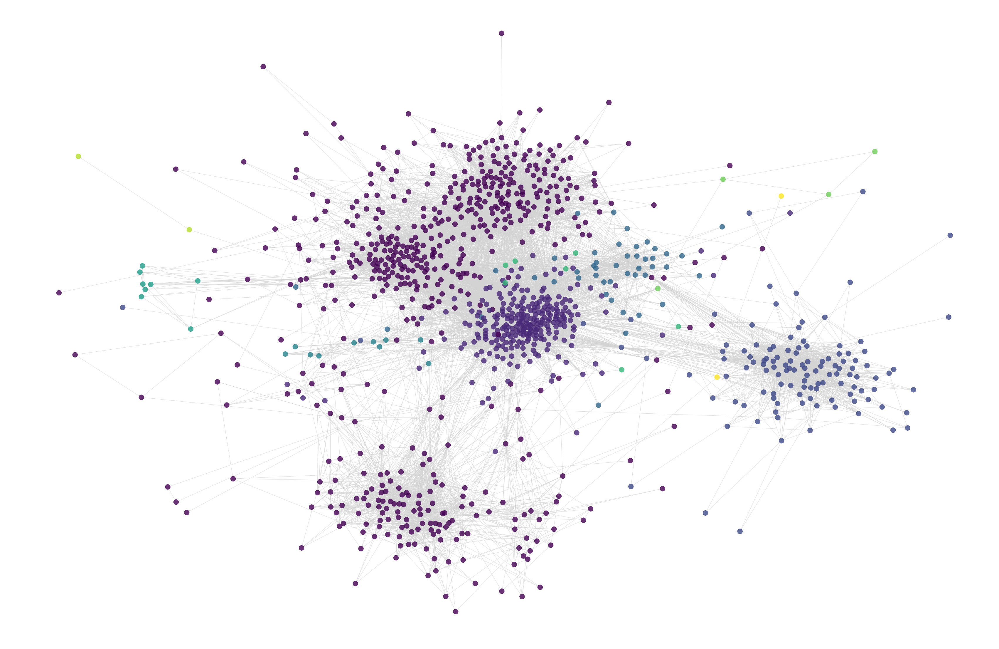

In [108]:
color_communities(total_mod_communities,L, lab=False,nodesize = 300, fontsize=6)

### Assortative Mixing
using the last lab

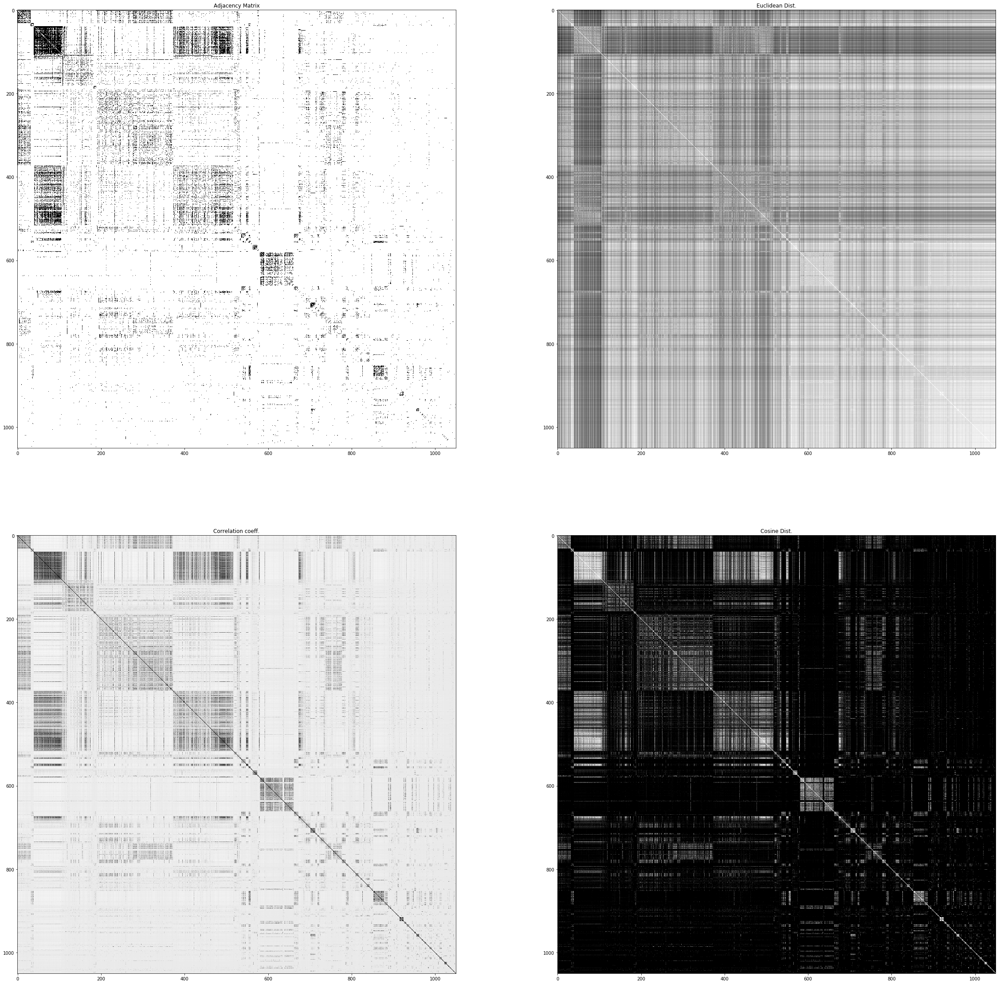

In [118]:
A = nx.to_numpy_matrix(L, dtype=int)
A = np.asarray(A)

def plotDist(A):
    
    f, ax = plt.subplots(2, 2, figsize=(40,40))
    ax[0, 0].imshow(A, cmap = 'Greys', interpolation = 'None')
    ax[0, 0].set_title('Adjacency Matrix')
    
    D = np.corrcoef(A)
    ax[1, 0].imshow(D, cmap = 'Greys', interpolation = 'None')
    ax[1, 0].set_title('Correlation coeff.')
    
    dVec = spt.distance.pdist(A, metric = 'euclidean')
    D = spt.distance.squareform(dVec)
    ax[0, 1].imshow(D, cmap = 'Greys', interpolation = 'None')
    ax[0, 1].set_title('Euclidean Dist.')
    
    dVec = spt.distance.pdist(A, metric = 'cosine')
    D = spt.distance.squareform(dVec)
    ax[1, 1].imshow(D, cmap = 'Greys', interpolation = 'None')
    ax[1, 1].set_title('Cosine Dist.')
    
plotDist(A)   

In [124]:
# Use Reverse Cuthill-McKee  for reordering
# run procedure
cm = nx.utils.reverse_cuthill_mckee_ordering(L)
# get permutation
l = [int(n) for n in cm]

A = nx.to_numpy_matrix(L)
A = np.asarray(A)
# apply reordering
A = A[np.ix_(l,l)]

plotDist(A)



IndexError: index 40340376 is out of bounds for axis 0 with size 1050

## Assortativity


In [125]:
nx.degree_assortativity_coefficient(L)

0.3509545370118079

In [126]:
nx.attribute_assortativity_coefficient(L, 'sex')

0.03878249948642938

In [130]:
nx.attribute_assortativity_coefficient(L, 'bdate')

-0.0019733025303953883

In [85]:
clique_color={}
i=3
for c in clique_communities:
    for node in c:
        clique_color[node] = i
    i+=1
for n in S.nodes():
    clique_color[n]=clique_color.get(n,i+1)*3
len(clique_color) == S.number_of_nodes()

True

In [86]:
clique_color

{'24700292': 9,
 '197222828': 9,
 '12963616': 9,
 '111020618': 9,
 '69825487': 12,
 '32845942': 12,
 '233733281': 9,
 '104035593': 9,
 '153791256': 9,
 '103006701': 9,
 '4090849': 9,
 '58371031': 9,
 '146073481': 12,
 '15156308': 9,
 '9089606': 9,
 '1137289': 9,
 '14374234': 9,
 '132600488': 9,
 '51525163': 9,
 '95308191': 9,
 '13123269': 12,
 '27192334': 12,
 '2523031': 12,
 '60712657': 12,
 '85010167': 12,
 '24834795': 12,
 '51058092': 12,
 '76864056': 12,
 '33818387': 12,
 '21269271': 12,
 '7269774': 12,
 '32369122': 12,
 '2543380': 12,
 '27001246': 12,
 '48078131': 12,
 '2322235': 12,
 '19938967': 12,
 '105522823': 12,
 '553196': 12,
 '25628758': 12,
 '9559540': 12,
 '6625510': 12,
 '27094302': 12,
 '21917994': 15,
 '72203807': 12,
 '41701144': 12,
 '16223930': 12,
 '3809201': 12,
 '57327561': 12,
 '2881398': 12,
 '25232674': 12,
 '15753805': 12,
 '26374113': 12,
 '64040244': 12,
 '184522054': 12,
 '14241945': 12,
 '99624854': 12,
 '15562886': 12,
 '33392564': 12,
 '3958533': 12,
 

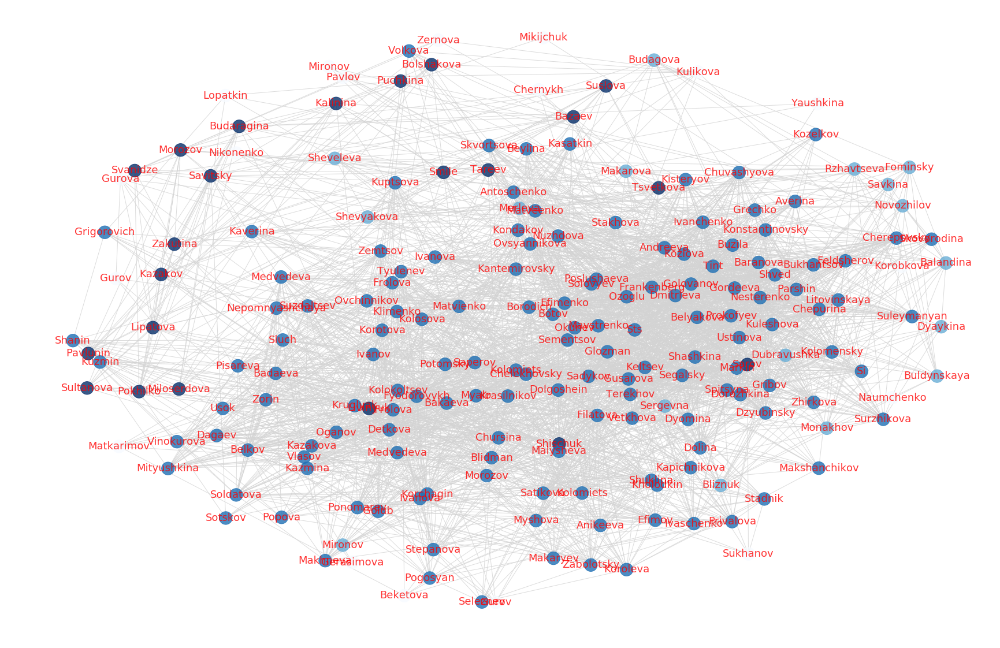

In [91]:
plt.figure(1, figsize=(30,20))
plt.axis('off')
pos = nx.spring_layout(S, k=17/np.sqrt(S.order()))
labels = nx.get_node_attributes(S, 'last_name')
nx.draw_networkx(S,
                     pos=pos,
                     node_size = 500,
                     node_color=[clique_color[n] for n in S.nodes()],
                     font_size=18,
                     font_color='red',
                     cmap=plt.cm.Blues,
                     with_labels=True,
                    labels=labels,
                    edge_color='lightgrey',
                     alpha=0.8
                )
plt.savefig('cliques.png')

That doesn't make any sence, so was not included in the presentation